## Augmentation functions of blend group
#### **[overview](https://imgaug.readthedocs.io/en/latest/source/overview/blend.html)** **[docs](https://imgaug.readthedocs.io/en/latest/source/api_augmenters_blend.html)**

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import imgaug as ia
from imgaug import augmenters as iaa
from imgaug import parameters as iap

In [7]:
image = ia.quokka(size=(1024, 1024), extract="square")

In [8]:
def print_aug(aug, n=16):
    # Augment images and segmaps.
    images_aug = []

    for _ in range(n):
        images_aug_i = aug(image=image)
        images_aug.append(images_aug_i)

    cells = []
    for image_aug in images_aug:
        cells.append(image_aug)                                      

    # Convert cells to a grid image and save.
    result_grid_image = ia.draw_grid(cells, cols=8)

    # plot functions 
    # note that the last image is augmented by matplotlib to make classes distingushable

    plt.figure()
    f, window = plt.subplots(1,1,figsize=(40,20)) 
    window.imshow(result_grid_image)
    window.axis('off')

72.2 ms ± 3.51 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

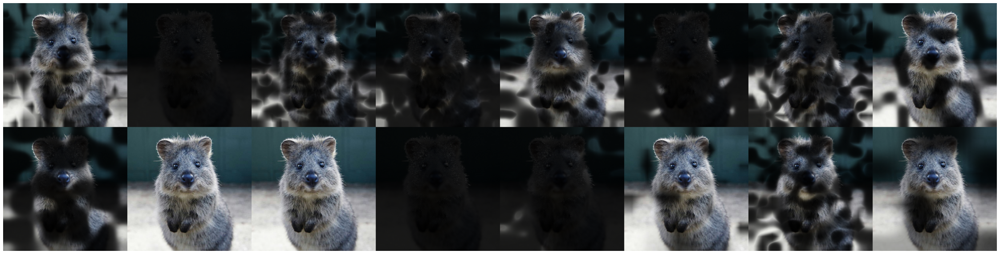

In [13]:
aug = iaa.BlendAlphaSimplexNoise(
    iaa.EdgeDetect(0.9))
%timeit test = aug(image=image)
print_aug(aug)

108 ms ± 5.66 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

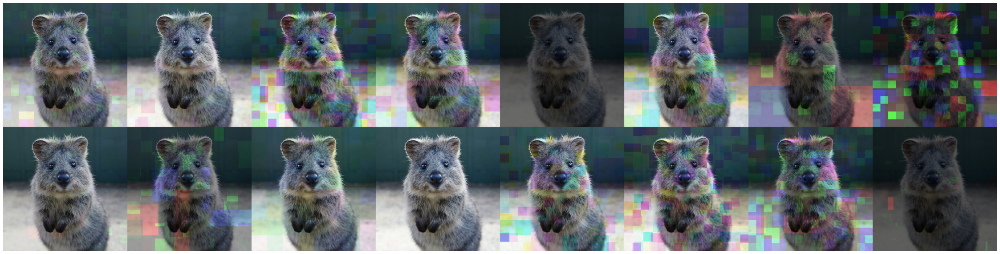

In [6]:
aug = iaa.BlendAlphaSimplexNoise(
        iaa.EdgeDetect(iap.Clip(iap.Absolute(iap.Normal(0.35, 0.18)), 0, 1)), 
        upscale_method="nearest",
        per_channel=True
    )
%timeit test = aug(image=image)
print_aug(aug)

106 ms ± 5.34 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

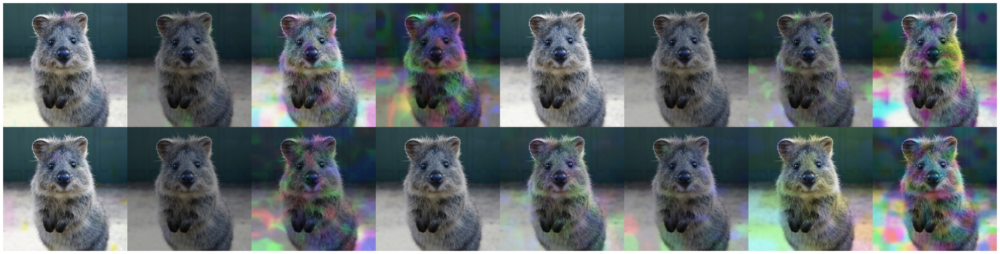

In [7]:
aug = iaa.BlendAlphaSimplexNoise(
    iaa.EdgeDetect(iap.Clip(iap.Absolute(iap.Normal(0.4, 0.18)), 0, 1)),
    upscale_method="linear",
    per_channel=True)
%timeit test = aug(image=image)
print_aug(aug)

96 ms ± 6.49 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

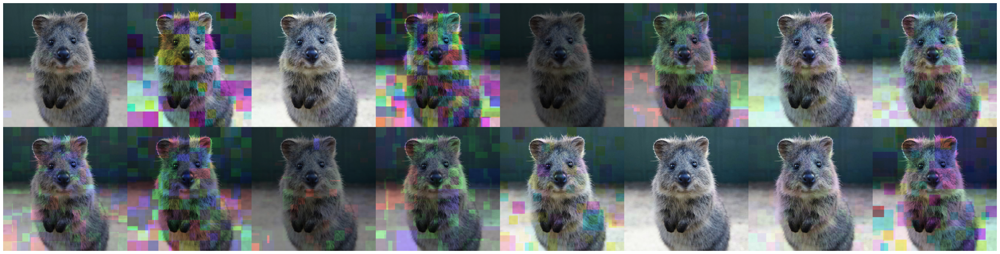

In [8]:
aug = iaa.BlendAlphaSimplexNoise(
    iaa.EdgeDetect(iap.Clip(iap.Absolute(iap.Normal(0.4, 0.18)), 0, 1)),
    upscale_method="nearest",
    per_channel=True)
%timeit test = aug(image=image)
print_aug(aug)

107 ms ± 3.65 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

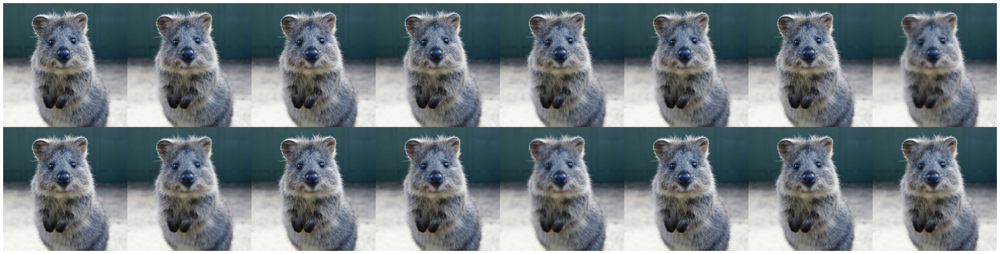

In [9]:
aug = iaa.BlendAlphaHorizontalLinearGradient(
    iaa.AveragePooling(iap.Poisson((3, 8))),
    start_at=(1.0, 0.0), end_at=(0.0, 0.5))
%timeit test = aug(image=image)
print_aug(aug)

<Figure size 432x288 with 0 Axes>

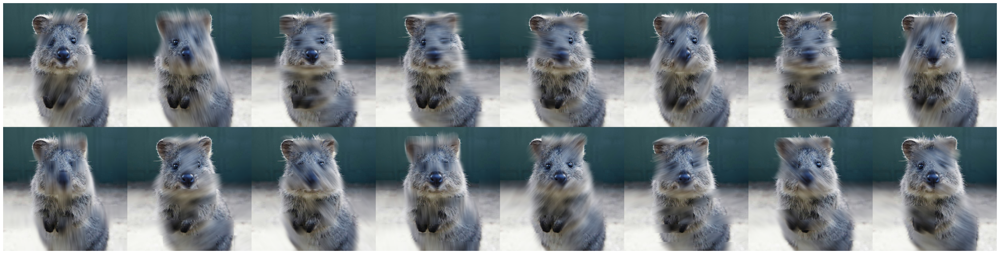

In [11]:
aug = iaa.BlendAlphaRegularGrid(
    nb_rows=(6, 15), 
    nb_cols=(5, 10),
    foreground=iaa.MotionBlur(k=80))
#%timeit test = aug(image=image)
print_aug(aug)

<Figure size 432x288 with 0 Axes>

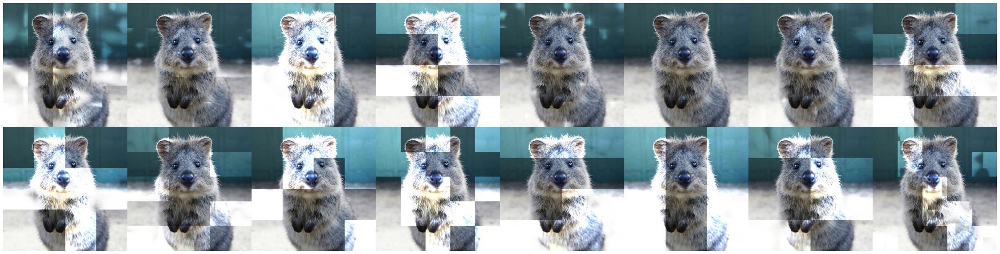

In [18]:
aug = iaa.BlendAlphaRegularGrid(
    nb_rows=(2, 5), 
    nb_cols=(2, 5),
    foreground=iaa.BlendAlphaSimplexNoise(iaa.Multiply((1.5,2.5))))
#%timeit test = aug(image=image)
print_aug(aug)